In [1]:
import pandas as pd
import scanpy as sc
import decoupler as dc
import liana as li
import scanpy as sc
import squidpy as sq
import celltypist
from celltypist import models

In [2]:

adata = sc.read_h5ad(r"/mnt/archive2/RO_src/data/adata_subset3.h5ad")

In [3]:
adata

AnnData object with n_obs × n_vars = 519722 × 17038
    obs: 'bin_count', 'array_row', 'array_col', 'labels_if_joint_source', 'n_genes_by_counts', 'total_counts', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_Ribo', 'pct_counts_Ribo', 'total_counts_Hb', 'pct_counts_Hb', 'leiden_clusters', '2_Smooth muscle Markers', 'AT1 Markers', 'AT2 Markers', 'B cell lineage Markers', 'EC arterial Markers', 'EC capillary Markers', 'EC venous Markers', 'Fibroblasts Markers', 'Innate lymphoid cell NK Markers', 'Lymphatic EC differentiating Markers', 'Lymphatic EC mature Markers', 'Macrophages Markers', 'Mast cells Markers', 'Monocytes Markers', 'T cell lineage Markers', 'Unknown Markers', 'cell_type_from_markers', '2_Smooth muscle_flag', '2_Smooth muscle_cell_type_cluster', 'AT1_flag', 'AT1_cell_type_cluster', 'AT2_flag', 'AT2_cell_type_cluster', 'B cell lineage_flag', 'B cell lineage_cell_type_cluster', 'EC arterial_flag', 'EC arterial_cell_type_cluster', 'EC capillary_flag', 'EC capillary_cell_ty

In [12]:
import matplotlib.pyplot as plt

# Loop over the unique cell types in adata.obs["cell_type"]
for cell_type in adata.obs["cell_type"].unique():
    # Create the scatter plot
    sq.pl.spatial_scatter(
        adata,
        color=cell_type,
        size=1,
        dpi=300,
        shape="circle",
        legend_fontsize=3.5,
    )

    # Save the figure to a certain path
    plt.savefig(f"/mnt/work/RO_src/STAnalysis/notebooks/downstream/ST/CCC/LIANA/{cell_type}_scatter.png")



: 

In [4]:
adata.var_names = adata.var_names.str.upper()
adata.var.index = adata.var.index.str.upper()

In [ ]:
model_config = {
    "Annotate": {
        "adata_to_use": "preprocessed_adata",
        "models": [
            {
                "model_name": "sclc_model",
                "model_path": "/mnt/work/RO_src/STAnalysis/STNav/models/model_sclc_lung.pkl",
                "usage": True,
                "params": {
                    "X": "adata",
                    "transpose_output": False,
                    "mode": "best match",
                    "p_thres": 0.5,
                    "majority_voting": False,
                    "min_prop": 0
                }
            },
            {
                "model_name": "healthy_model",
                "model_path": "/mnt/work/RO_src/STAnalysis/STNav/models/model_healthy_lung.pkl",
                "usage": True,
                "params": {
                    "X": "adata",
                    "transpose_output": False,
                    "mode": "best match",
                    "p_thres": 0.5,
                    "majority_voting": False,
                    "min_prop": 0
                }
            }
        ]
    }
}

In [ ]:


# Preprocess the data
# Re-add the raw counts to the X and raw
adata.X = adata.layers["raw_counts"].copy()

# Normalize for CellTypist prediction
st_adata_to_annotate: sc.AnnData = adata.copy()
sc.pp.normalize_total(adata=st_adata_to_annotate, target_sum=1e4)
sc.pp.log1p(st_adata_to_annotate)
st_adata_to_annotate.var_names = st_adata_to_annotate.var_names.str.upper()

# Create a dictionary to store the models and their predictions
model_predictions: dict = {}

for model_info in model_config["Annotate"]["models"]:
	if model_info["usage"]:
		# Load the model
		model_path: str = model_info["model_path"]
		model = models.Model.load(model=model_path)

		# Get model-specific parameters
		annotation_params = model_info["params"]

		# Predict with the model
		predictions = celltypist.annotate(
			st_adata_to_annotate,
			model=model,
			majority_voting=annotation_params["majority_voting"],
			mode=annotation_params["mode"],
			p_thres=annotation_params["p_thres"],
			min_prop=annotation_params["min_prop"],
		)

		# Store the predictions
		adata_pred: sc.AnnData = predictions.to_adata().copy()
		model_name: str = model_info["model_name"]
		model_predictions[model_name] = adata_pred

# Combine the predictions
for model_name, adata_pred in model_predictions.items():
	adata.obs[f"predicted_labels_{model_name}"] = adata_pred.obs[
		"predicted_labels"
	]
	adata.obs[f"conf_score_{model_name}"] = adata_pred.obs["conf_score"]

# Determine the highest confidence score for each cell
model_names = list(model_predictions.keys())
conf_score_columns: list[str] = [f"conf_score_{name}" for name in model_names]

highest_conf_model = adata.obs[conf_score_columns].idxmax(axis=1)

highest_conf_labels = highest_conf_model.map(
	arg=lambda x: x.replace("conf_score_", "")
)
highest_conf_labels = adata.obs[
	[f"predicted_labels_{name}" for name in model_names]
].values[
	range(len(highest_conf_model)),
	highest_conf_labels.map(arg=lambda x: model_names.index(x)),
]
# Create the final annotation
adata.obs["cell_type"] = highest_conf_labels

# Convert 'predicted_labels' into dummy variables
dummies: pd.DataFrame = pd.get_dummies(data=adata.obs["cell_type"])

# Convert True/False to 1/0
dummies = dummies.astype(dtype=int)

# Add the dummy variables to the original DataFrame
adata.obs = pd.concat(objs=[adata.obs, dummies], axis=1)

In [ ]:
adata.write_h5ad(r"./adata_subset3.h5ad")

In [ ]:
sq.pl.spatial_scatter(
    adata,
    color=f"cell_type",  # use the column from the whole dataframe
    size=1,
    dpi=1500,   
	shape="circle",
    legend_fontsize=3.5,  # adjust this value to make the legend smaller
)

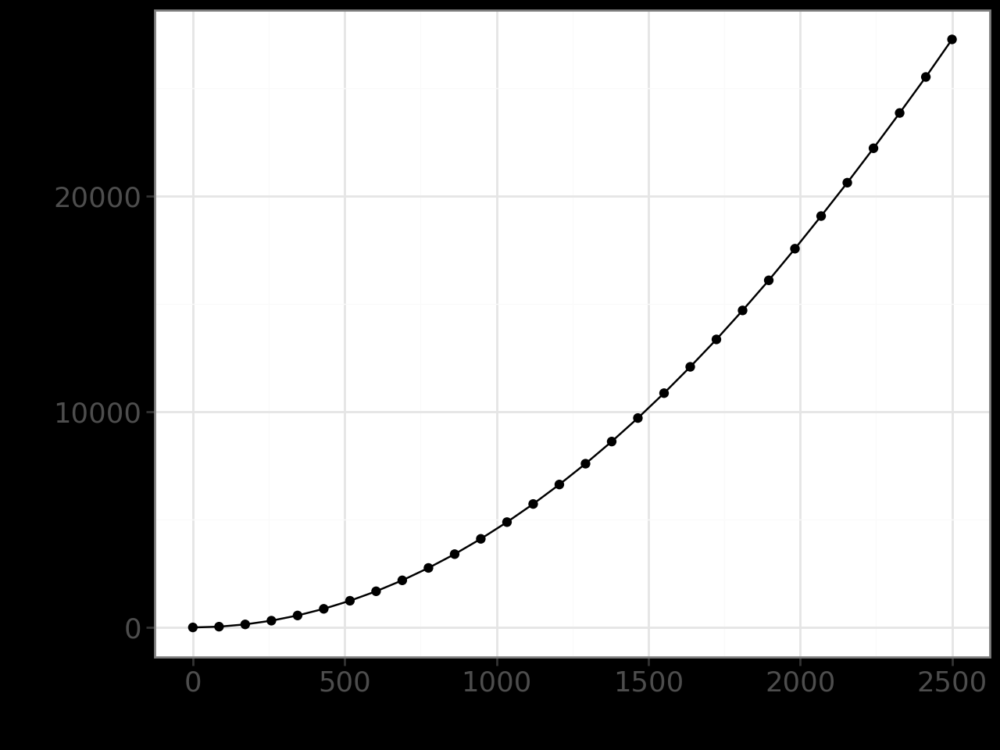

In [7]:
plot, _ = li.ut.query_bandwidth(coordinates=adata.obsm['spatial'], start=0, end=2500, interval_n=30)
plot

In [ ]:
li.ut.spatial_neighbors(
    adata,
    bandwidth=25,
    cutoff=0.15,
    kernel="gaussian",
    set_diag=False,
    max_neighbours=500,
)

In [5]:
from plotnine import ggplot, aes, geom_point, theme_minimal, labs, theme
import anndata
import pandas as pd

from liana._logging import _logg
from liana._docs import d
from liana._constants import Keys as K, DefaultValues as V

In [6]:
def connectivity(adata: anndata.AnnData,
                 idx: int,
                 spatial_key=K.spatial_key,
                 connectivity_key=K.connectivity_key,
                 size=1,
                 figure_size=(5.4, 5),
                 return_fig: bool = V.return_fig):
    """
    Plot spatial connectivity weights.

    Parameters
    ----------
    %(adata)s
    %(spatial_key)s
    %(connectivity_key)s
    size
        Size of the points
    %(figure_size)s
    %(return_fig)s

    Returns
    -------
    A `plotnine.ggplot` instance

    """

    assert connectivity_key in list(adata.obsp.keys())
    assert spatial_key in adata.obsm_keys()

    _logg("This function will be deprecated in the next version. " +
          "Please use scanpy or squidpy for plotting spatial connectivities.", level='warn')

    coordinates = pd.DataFrame(adata.obsm[spatial_key],
                               index=adata.obs_names,
                               columns=['x', 'y']).copy()
    coordinates['connectivity'] = adata.obsp[connectivity_key][:, idx].toarray()
    coordinates['y'] = coordinates['y'].max() - coordinates['y'] # flip y

    p = (ggplot(coordinates.sort_values('connectivity', ascending=True),
                aes(x='x', y='y', colour='connectivity'))
         + geom_point(size=size, shape='8')
         + theme_minimal()
         + labs(colour='connectivity', y='y Coordinate', x='x Coordinate')
         + theme(figure_size=figure_size)
         )


    if return_fig:
        return p

    p.draw()


In [ ]:
connectivity(adata=adata, idx=10, size=0.1, figure_size=(25, 25))


In [ ]:
connectivity(adata=adata, idx=10, size=0.1, figure_size=(25, 25))


In [ ]:
li.mt.bivariate(
    adata,
    layer="lognorm_counts",
    resource_name="consensus",  # NOTE: uses HUMAN gene symbols!
    local_name="cosine",  # Name of the function
    global_name="morans",  # Name global function
    n_perms=100,  # Number of permutations to calculate a p-value
    mask_negatives=False,  # Whether to mask LowLow/NegativeNegative interactions
    add_categories=True,  # Whether to add local categories to the results
    nz_prop=0.01,  # Minimum expr. proportion for ligands/receptors and their subunits
    use_raw=False,
    verbose=True,
)

In [ ]:
adata.write_h5ad(r"/mnt/archive2/RO_src/data/processed/adata_subset_liana_v2.h5ad")

In [2]:
adata = sc.read_h5ad(r"/mnt/work/workbe nch/rafaed/work/RO_src/adata_liana_v2.h5ad")


In [4]:
adata

AnnData object with n_obs × n_vars = 519722 × 17038
    obs: 'bin_count', 'array_row', 'array_col', 'labels_if_joint_source', 'n_genes_by_counts', 'total_counts', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_Ribo', 'pct_counts_Ribo', 'total_counts_Hb', 'pct_counts_Hb', 'leiden_clusters', '2_Smooth muscle Markers', 'AT1 Markers', 'AT2 Markers', 'B cell lineage Markers', 'EC arterial Markers', 'EC capillary Markers', 'EC venous Markers', 'Fibroblasts Markers', 'Innate lymphoid cell NK Markers', 'Lymphatic EC differentiating Markers', 'Lymphatic EC mature Markers', 'Macrophages Markers', 'Mast cells Markers', 'Monocytes Markers', 'T cell lineage Markers', 'Unknown Markers', 'cell_type_from_markers', '2_Smooth muscle_flag', '2_Smooth muscle_cell_type_cluster', 'AT1_flag', 'AT1_cell_type_cluster', 'AT2_flag', 'AT2_cell_type_cluster', 'B cell lineage_flag', 'B cell lineage_cell_type_cluster', 'EC arterial_flag', 'EC arterial_cell_type_cluster', 'EC capillary_flag', 'EC capillary_cell_ty

In [45]:
sig_data = adata.uns["liana_res"][(adata.uns["liana_res"]["cellphone_pvals"] < 0.05) & (adata.uns["liana_res"]["lr_logfc"] > 0.5)]

In [46]:
import pycirclize
from pycirclize import Circos
import pandas as pd
from pycirclize.parser import Matrix


## Extract liana_res
df1 = sig_data[['source','target']].groupby(['source','target']).size().reset_index(name='counts')

In [47]:
df = df1.pivot(index='source',columns='target',values='counts')


In [48]:
len(df.index)

19

In [49]:
common_cols = [value for value in df.index if value in df.columns]
df = df[common_cols]
df.fillna(0, inplace=True)
matrix_data=df.values


In [50]:
import matplotlib.pyplot as plt

# Set the default background color of all plots to white
plt.rcParams['figure.facecolor'] = 'white'

In [51]:
matrix_df = pd.DataFrame(matrix_data, index=common_cols, columns=common_cols)


In [61]:
def link_kws_handler(from_label: str, to_label: str):
    ## Highlith Astro, CR, Microglia source
    if from_label in ('SCLC-A', 'SCLC-P', 'SCLC-N','Fibroblast','B cell','T cell','Macrophage'):
        # Set alpha, zorder values higher than other links for highlighting
        return dict(alpha=0.5, zorder=1.0)
    else:
     return dict(alpha=0.1, zorder=1.0)

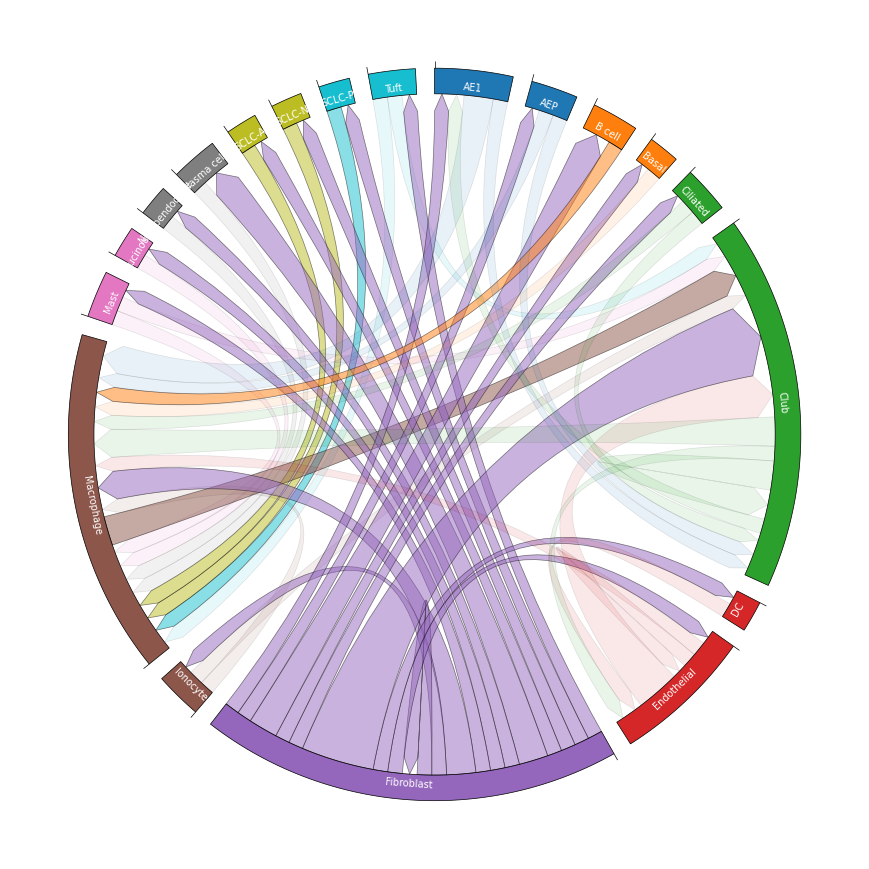

In [62]:

# Initialize from matrix (Can also directly load tsv matrix file)
circos = Circos.initialize_from_matrix(
    matrix_df,
    space=3,
    cmap="tab10",
    r_lim=(93, 100),
    ticks_interval=500,
    label_kws=dict(r=94, size=7, color="white"),
    link_kws=dict(direction=1, ec="black", lw=0.5),
    link_kws_handler=link_kws_handler,

)

#print(matrix_df)
fig = circos.plotfig()


In [5]:
lrdata = adata.obsm['local_scores']


KeyError: 'local_scores'

In [56]:
lrdata.var.sort_values("mean", ascending=False).head(3)


,ligand,receptor,ligand_means,ligand_props,receptor_means,receptor_props,morans,morans_pvals,mean,std
interaction,,,,,,,,,,
TIMP1^CD63,TIMP1,CD63,0.076222,0.093358,0.080097,0.099419,0.004073,0.0,0.084829,0.133741
APP^CD74,APP,CD74,0.077191,0.097100,0.136757,0.135228,-0.009577,0.0,0.073719,0.122991
ADCYAP1^RAMP2,ADCYAP1,RAMP2,0.089699,0.109018,0.031092,0.040502,0.005311,0.0,0.058008,0.127271


In [ ]:
lrdata.var.sort_values("std", ascending=False).head(3)


In [ ]:
lrdata.var.sort_values("morans", ascending=False).head()


In [63]:
lrdata

AnnData object with n_obs × n_vars = 519722 × 177
    obs: 'bin_count', 'array_row', 'array_col', 'labels_if_joint_source', 'n_genes_by_counts', 'total_counts', 'total_counts_Mt', 'pct_counts_Mt', 'total_counts_Ribo', 'pct_counts_Ribo', 'total_counts_Hb', 'pct_counts_Hb', 'leiden_clusters', '2_Smooth muscle Markers', 'AT1 Markers', 'AT2 Markers', 'B cell lineage Markers', 'EC arterial Markers', 'EC capillary Markers', 'EC venous Markers', 'Fibroblasts Markers', 'Innate lymphoid cell NK Markers', 'Lymphatic EC differentiating Markers', 'Lymphatic EC mature Markers', 'Macrophages Markers', 'Mast cells Markers', 'Monocytes Markers', 'T cell lineage Markers', 'Unknown Markers', 'cell_type_from_markers', '2_Smooth muscle_flag', '2_Smooth muscle_cell_type_cluster', 'AT1_flag', 'AT1_cell_type_cluster', 'AT2_flag', 'AT2_cell_type_cluster', 'B cell lineage_flag', 'B cell lineage_cell_type_cluster', 'EC arterial_flag', 'EC arterial_cell_type_cluster', 'EC capillary_flag', 'EC capillary_cell_type

In [ ]:
sc.set_figure_params(dpi=80, dpi_save=300, format='png', frameon=False, transparent=True, figsize=[5,5])


In [4]:

sq.pl.spatial_scatter(
    lrdata,
    color=f"TIMP1^CD63",
	layer="pvals",
    size=1.25,
    dpi=300,
    shape="circle",
    legend_fontsize=3.5,
    figsize=(24,12)
)



NameError: name 'lrdata' is not defined

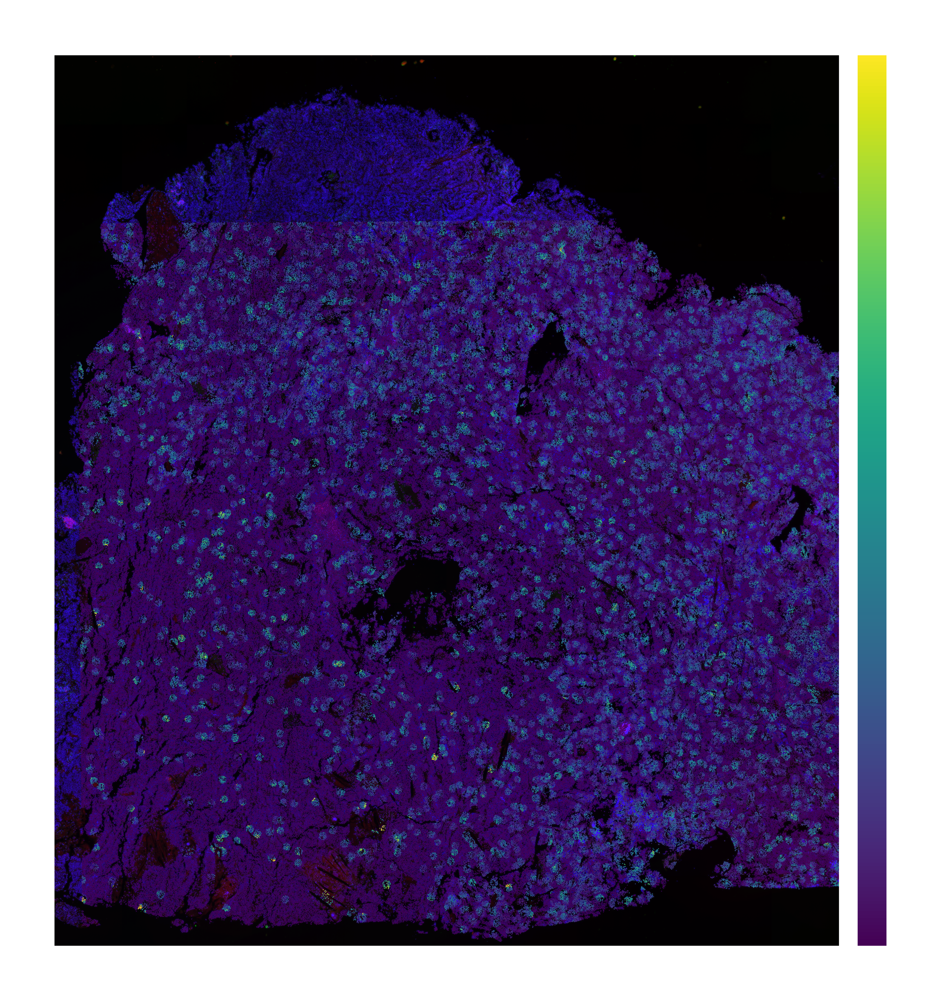

In [67]:

sq.pl.spatial_scatter(
    lrdata,
    color=f"TIMP1^CD63",
    size=1.25,
    dpi=300,
    shape="circle",
    legend_fontsize=3.5,
    figsize=(24,12)
)



In [ ]:
sq.pl.spatial_scatter(
    lrdata,
    color=f"VIM^CD44",  # use the column from the whole dataframe
    size=1,
    dpi=100,   
	shape="circle",
    legend_fontsize=3.5,  # adjust this value to make the legend smaller
)

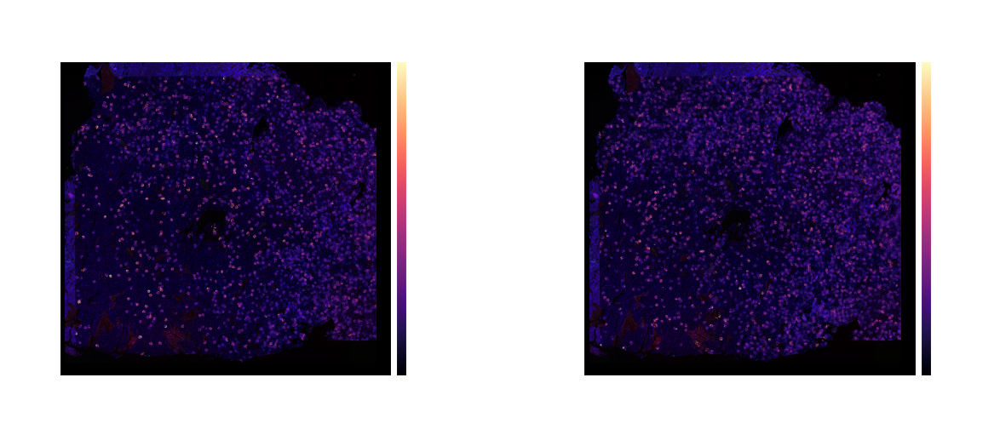

In [69]:
sc.pl.spatial(lrdata, color=['ADCYAP1^RAMP2', 'TIMP1^CD63'], size=1.4, vmax=1, cmap='magma')


In [ ]:
sc.pl.spatial(adata, color=['ADCYAP1', 'RAMP2',
                            'TIMP1', 'CD63'],
              size=1.4, ncols=2)